# Advanced Lane Finding Project

The goals / steps of this project are the following:

* Compute the camera calibration matrix and distortion coefficients given a set of chessboard images.
* Apply a distortion correction to raw images.
* Use color transforms, gradients, etc., to create a thresholded binary image.
* Apply a perspective transform to rectify binary image ("birds-eye view").
* Detect lane pixels and fit to find the lane boundary.
* Determine the curvature of the lane and vehicle position with respect to center.
* Warp the detected lane boundaries back onto the original image.
* Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position.

---

## Camera Calibration

To correctly display the size and shapes of 3d objects we first have to take into account the distortion inherent to the camera's setting. We start by calculating the distortion coefficients by looking at images of pre-defined checkboard patterns:

In [1]:
import numpy as np
import cv2
import glob
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import matplotlib.animation
from matplotlib import rcParams
import os
%matplotlib inline

rcParams['axes.titlepad'] = 20 
rcParams['xtick.labelsize'] = 20 # fontsize of the tick labels
rcParams['ytick.labelsize'] = 20 # fontsize of the tick labels
rcParams['figure.subplot.hspace'] = 0.3 # fontsize of the tick labels
rcParams["animation.html"] = "html5"

In [2]:

# prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
objp = np.zeros((6*9,3), np.float32)
objp[:,:2] = np.mgrid[0:9,0:6].T.reshape(-1,2)

# Arrays to store object points and image points from all the images.
objpoints = [] # 3d points in real world space
imgpoints = [] # 2d points in image plane.

# Make a list of calibration images
images = glob.glob('camera_cal/calibration*.jpg')

# Step through the list and search for chessboard corners
for fname in images:
    img = cv2.imread(fname)
    gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)

    # Find the chessboard corners
    ret, corners = cv2.findChessboardCorners(gray, (9,6),None)

    # If found, add object points, image points
    if ret == True:
        objpoints.append(objp)
        imgpoints.append(corners)

        # Draw and display the corners
        img = cv2.drawChessboardCorners(img, (9,6), corners, ret)
        cv2.imshow('img',img)
        cv2.waitKey(500)

cv2.destroyAllWindows()

In the previous step we searched for checkboard corners using cv2's built-int *drawChessboardCorners* function. Next we will apply *calibrateCamera* on the object points and corresponding image points to find the matrices used to undistort images produced with our camera

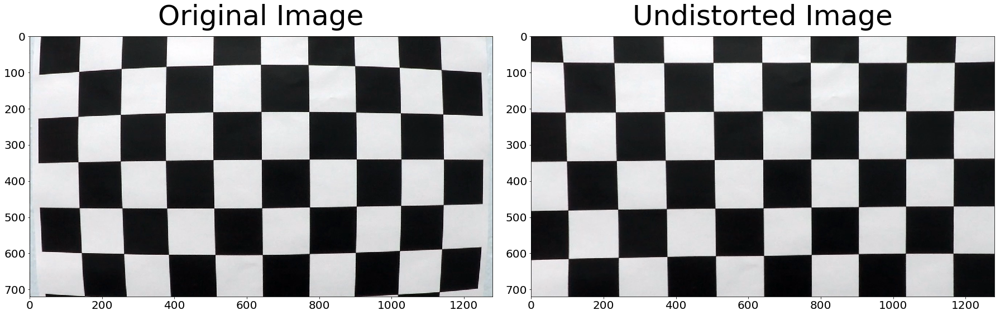

In [3]:
def cal_undistort(img, objpoints, imgpoints):
    ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, img.shape[1:], None, None)
    undist = cv2.undistort(img, mtx, dist, None, mtx)
    return undist


image=cv2.imread(images[0])
undistorted = cal_undistort(image, objpoints, imgpoints)

f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(image)
ax1.set_title('Original Image', fontsize=50)
ax2.imshow(undistorted)
ax2.set_title('Undistorted Image', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

Let's clean up the cal_undistort function by using the calibration parameter as global variables to make it easier to use later on:

In [4]:
ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, img.shape[1:], None, None)
def undistort_image(img):
    undist = cv2.undistort(img, mtx, dist, None, mtx)
    return undist

## Lane Detection Pipeline

Now that the camera is correctly calibrated, we can have a look at some undistorted test images:

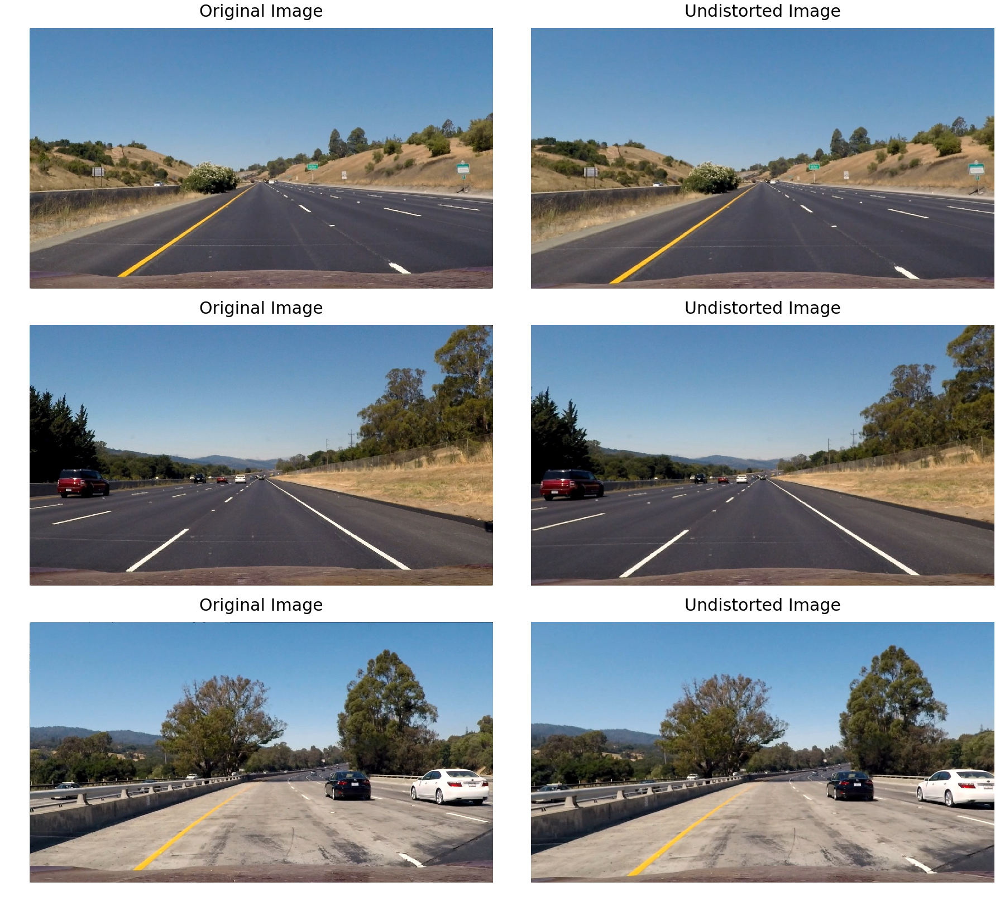

In [5]:
n=3
test_images=os.listdir("test_images/")
titles = ["Original Image", "Undistorted Image"]
fig, ax = plt.subplots(n,2,figsize=(24,24))
fig.tight_layout()

for i in range(0, n):
    image=mpimg.imread("test_images/"+test_images[i])
    undistorted = undistort_image(image)
    ax[i][0].imshow(image)
    ax[i][0].set_title(titles[0], fontsize=30)
    ax[i][0].axis('off')
    ax[i][1].imshow(undistorted)
    ax[i][1].set_title(titles[1], fontsize=30)
    ax[i][1].axis('off')

plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
plt.show()

## Gradients and Color Spaces
In the following, we will apply a series of thresholding and color transformations to isolate the lane markings. In the end we will try to stack the lane lines we get from different algorithms in order to obtain a more robust identification of the lane markings.

### Sobel transform
See https://github.com/HandMi/CarND-ImageThresholding for further analysis of [Sobel derivatives](https://docs.opencv.org/2.4.13.7/doc/tutorials/imgproc/imgtrans/sobel_derivatives/sobel_derivatives.html). Here we are going to collect the result:

In [154]:
# Sobel pipeline
def apply_sobel(img, sobel_kernel=3, sob_thresh=(0, 255), mag_thresh=(0, 255), dir_thresh=(0, np.pi/2)):
    # Take both Sobel x and y gradients
    sobel_x = cv2.Sobel(img, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobel_y = cv2.Sobel(img, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    
    # Compute absolute values
    abs_sobel_x = np.absolute(sobel_x)
    abs_sobel_y = np.absolute(sobel_y)
    
    scaled_sobel_x = np.uint8(255*abs_sobel_x/np.max(abs_sobel_x))
    scaled_sobel_y = np.uint8(255*abs_sobel_y/np.max(abs_sobel_y))
    
    ## Treshold in x-direction
    binary_x = np.zeros_like(scaled_sobel_x)
    binary_x[(scaled_sobel_x >= sob_thresh[0]) & (scaled_sobel_x <= sob_thresh[1])] = 1
 
    ## Treshold in y-direction
    binary_y = np.zeros_like(scaled_sobel_y)
    binary_y[(scaled_sobel_y >= sob_thresh[0]) & (scaled_sobel_y <= sob_thresh[1])] = 1
 
    ## Magnitude threshold
    # Calculate the gradient magnitude
    abs_grad = np.sqrt(sobel_x**2 + sobel_y**2)
    # Rescale to 8 bit
    scaled_grad= np.uint8(255*abs_grad/np.max(abs_grad))
    # Create a binary image of ones where threshold is met, zeros otherwise
    binary_mag = np.zeros_like(scaled_grad)
    binary_mag[(scaled_grad >= mag_thresh[0]) & (scaled_grad <= mag_thresh[1])] = 1
    
    ## Direction threshold
    grad_dir = np.arctan2(abs_sobel_y, abs_sobel_x)
    
    # Create a binary image of ones where threshold is met, zeros otherwise
    binary_dir = np.zeros_like(grad_dir)
    binary_dir[(grad_dir >= dir_thresh[0]) & (grad_dir <= dir_thresh[1])] = 1
    
    
    # Combine all results
    bin_combined = np.zeros_like(binary_x)
    bin_combined[((binary_x == 1) & (binary_y == 1)) | ((binary_mag == 1) & (binary_dir == 1))] = 1
    return bin_combined

Let's test it on some of the test_images:

In [7]:
SOBEL_KERNEL_SIZE=5
SOBEL_THRESHOLD=(20, 255)
MAGNITUDE_THRESHOLD=(30, 360)
DIRECTIONAL_THRESHOLD=(0, np.pi/4)

In [155]:
def sobel_filter(img):
    ret = apply_sobel(img, SOBEL_KERNEL_SIZE, SOBEL_THRESHOLD, MAGNITUDE_THRESHOLD, DIRECTIONAL_THRESHOLD)
    return ret*255

In [156]:
def grayscale(img):
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    ret = cv2.addWeighted(hls[:,:,2],0.5,img[:,:,0],0.5,0)
    return ret

We apply the Sobel filter to the image created by averaging the HLS-S channel and the RGB-R channel:

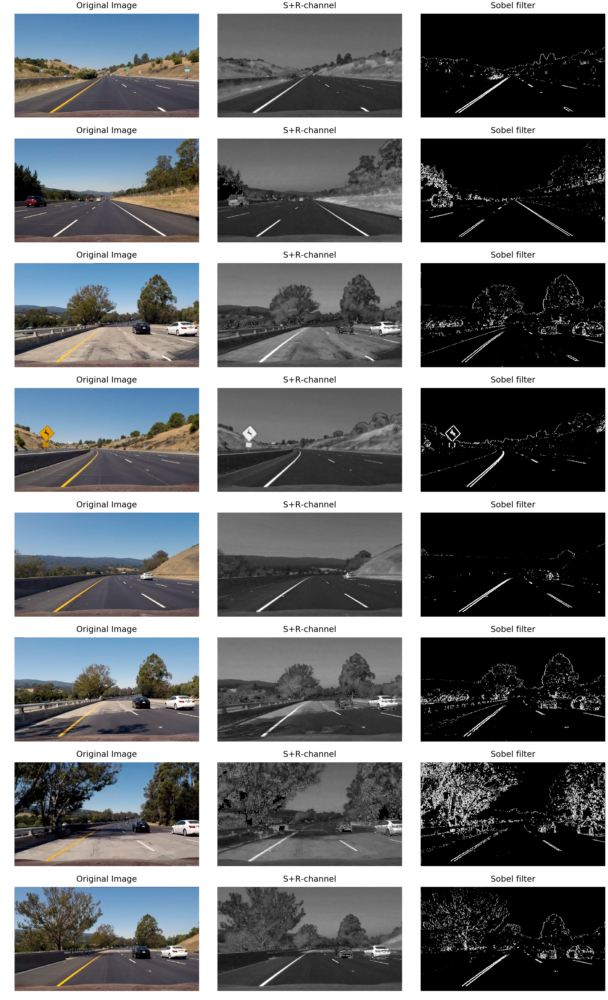

In [157]:
n=8
test_images=os.listdir("test_images/")
titles = ["Original Image", "S+R-channel", "Sobel filter"]
fig, ax = plt.subplots(n,3,figsize=(30,50))
fig.tight_layout()

for i in range(0, n):
    image = mpimg.imread("test_images/"+test_images[i])
    gray = grayscale(image)
    sobel_filtered = sobel_filter(gray)
    ax[i][0].imshow(image)
    ax[i][0].set_title(titles[0], fontsize=30)
    ax[i][0].axis('off')
    ax[i][1].imshow(gray ,'gray')
    ax[i][1].set_title(titles[1], fontsize=30)
    ax[i][1].axis('off')
    ax[i][2].imshow(sobel_filtered ,'gray')
    ax[i][2].set_title(titles[2], fontsize=30)
    ax[i][2].axis('off')

plt.subplots_adjust(left=0., right=1, top=1.0, bottom=0.)
plt.show()

As we can see, the lane markings are clearly discernible. However, we will stack another color filtered image on top using the HSV-based filter from the first project:

In [59]:
dark_yellow = (18, 70, 150)
light_yellow = (35,255,255)
dark_white = (0, 0, 150)
light_white = (255,25,255)

In [50]:
%%capture
import helpers.color_animation
fig, ax = plt.subplots()
ani_1 = helpers.color_animation.animate_hsv_colors(fig, ax, dark_yellow, light_yellow,60)

In [51]:
ani_1

In [52]:
%%capture
fig, ax = plt.subplots()
ani_2 = helpers.color_animation.animate_hsv_colors(fig, ax, dark_white, light_white,60)

In [53]:
ani_2

In [164]:
def hsv_color_filter(image):
    hsv = cv2.cvtColor(image, cv2.COLOR_RGB2HSV)
    image_yellow = cv2.inRange(hsv, dark_yellow, light_yellow)
    image_white = cv2.inRange(hsv, dark_white, light_white)
    ret_image = image_white+image_yellow
    return ret_image

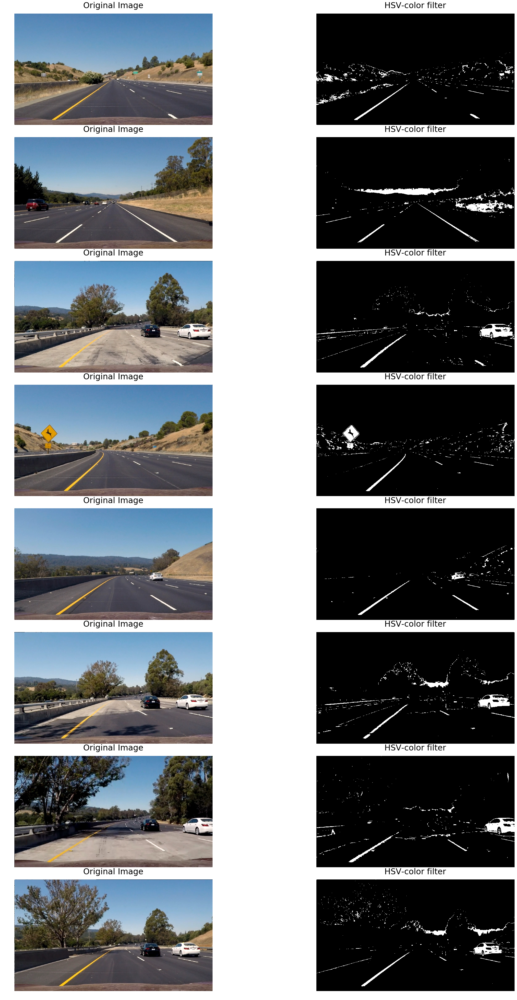

In [165]:
n=8
test_images=os.listdir("test_images/")
titles = ["Original Image",  "HSV-color filter"]
fig, ax = plt.subplots(n,2,figsize=(30,50))
fig.tight_layout()

for i in range(0, n):
    image = mpimg.imread("test_images/"+test_images[i])
    filtered = hsv_color_filter(image)
    ax[i][0].imshow(image)
    ax[i][0].set_title(titles[0], fontsize=30)
    ax[i][0].axis('off')
    ax[i][1].imshow(filtered ,'gray')
    ax[i][1].set_title(titles[1], fontsize=30)
    ax[i][1].axis('off')

plt.subplots_adjust(left=0., right=1, top=1.0, bottom=0.)
plt.show()

In [168]:
def apply_filter(image):
    gray = grayscale(image)
    sobel = sobel_filter(gray)
    hsv_color_mask = color_filter(image)
    ret = cv2.addWeighted(sobel,0.5,hsv_color_mask,0.5,0)
    return ret

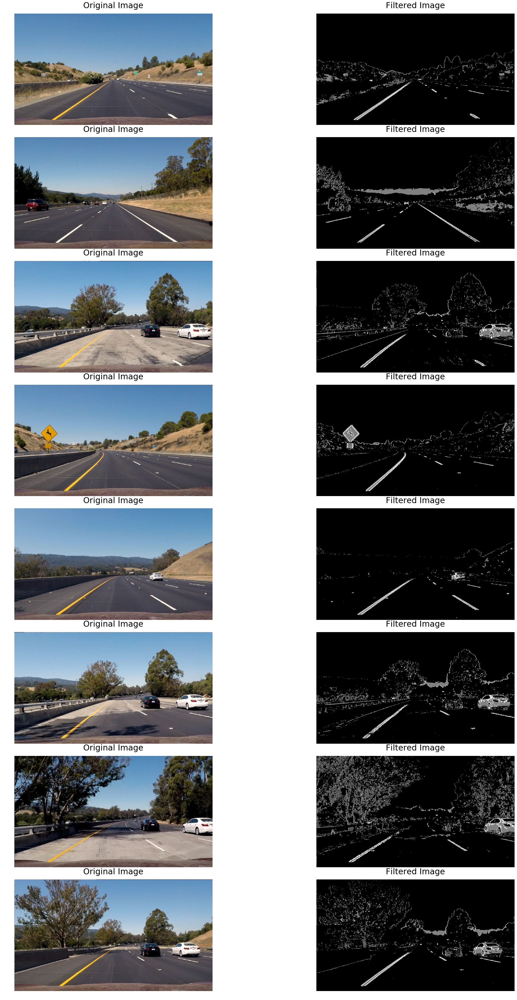

In [170]:
n=8
test_images=os.listdir("test_images/")
titles = ["Original Image",  "Filtered Image"]
fig, ax = plt.subplots(n,2,figsize=(30,50))
fig.tight_layout()

for i in range(0, n):
    image = mpimg.imread("test_images/"+test_images[i])
    filtered = apply_filter(image)
    ax[i][0].imshow(image)
    ax[i][0].set_title(titles[0], fontsize=30)
    ax[i][0].axis('off')
    ax[i][1].imshow(filtered ,'gray')
    ax[i][1].set_title(titles[1], fontsize=30)
    ax[i][1].axis('off')

plt.subplots_adjust(left=0., right=1, top=1.0, bottom=0.)
plt.show()

In the filtered image pixels that were detected by both filters are white, while pixels that were only detected by one of the filters are depicted as gray.

Next we are going to apply our filter to a warp image of the road.

## Perspective Transform